# 下巻 第4章 解答例

ここでは、 **本書の学習内容の定着** を目的とした練習問題とその解答・解説を掲載します。
なお、問題の性質上、本書で取り上げた処理と重複することがあります。
ご了承ください。

## 前提

以下のように、ライブラリのインポートと変数の定義が完了していることを前提とします。

In [1]:
# itertoolsモジュールのインポート
# 効率的なループを実行するためのイテレータビルディングブロックを提供
# これにより、データのコンビネーションや順列などを簡潔に表現できる
import itertools

# collectionsモジュールからOrderedDictのインポート
# OrderedDictは順序を保持する辞書型
from collections import OrderedDict

# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsのインポート
# より詳細なグラフ作成機能を利用可能
# goという名前で参照可能
import plotly.graph_objects as go

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

# plotly.subplotsからmake_subplotsのインポート
# 複数のサブプロットを含む複合的な図を作成する際に使用
from plotly.subplots import make_subplots

In [2]:
# マンガデータ保存ディレクトリのパス
DIR_CM = Path("../../../data/cm/input")
# アニメデータ保存ディレクトリのパス
DIR_AN = Path("../../../data/an/input")
# ゲームデータ保存ディレクトリのパス
DIR_GM = Path("../../../data/gm/input")

In [3]:
# 読み込み対象ファイル名の定義

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# マンガ作品と原作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

# アニメ各話に関するファイル
FN_AE = "an_ae.csv"

# アニメ作品と声優の対応関係に関するファイル
FN_AC_ACT = "an_ac_act.csv"

# ゲームパッケージとプラットフォームの対応関係に関するファイル
FN_PKG_PF = "gm_pkg_pf.csv"

In [4]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

In [5]:
# 国内主要ゲームメーカーのプラットフォームとメーカー名の対応辞書
# キー: プラットフォーム名、値: メーカー名の略称
PF2MK = {
    "プレイステーション": "ソニー",
    "プレイステーション2": "ソニー",
    "プレイステーション・ポータブル": "ソニー",
    "プレイステーション3": "ソニー",
    "プレイステーションVita": "ソニー",
    "プレイステーション4": "ソニー",
    "ゲームアーカイブス": "ソニー",
    "SG-1000": "セガ",
    "SC-3000": "セガ",
    "SEGAマーク3": "セガ",
    "セガ・マスターシステム": "セガ",
    "メガドライブ": "セガ",
    "ゲームギア": "セガ",
    "セガサターン": "セガ",
    "ドリームキャスト": "セガ",
    "ファミリーコンピュータ": "任天堂",
    "ゲームボーイ": "任天堂",
    "スーパーファミコン": "任天堂",
    "NINTENDO64": "任天堂",
    "ゲームボーイアドバンス": "任天堂",
    "ニンテンドーゲームキューブ": "任天堂",
    "ニンテンドーDS": "任天堂",
    "ニンテンドー3DS": "任天堂",
    "Wii": "任天堂",
    "WiiU": "任天堂",
    "NintendoSwitch": "任天堂",
}

In [6]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

また、本書中で取り上げた以下の関数も、同様に利用可能とします。

In [7]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [17]:
def add_jitter(values: pd.Series, scale: float = 0.3, seed: int = None) -> pd.Series:
    """
    与えられた値にジッタリング（ランダムなノイズ）を適用する

    Parameters
    ----------
    values : pd.Series
        ジッタリングを適用する数値が含まれるPandasのSeries
    scale : float, optional
        ランダムノイズの大きさを調整するためのスケール因子、デフォルトは0.3
    seed : int, optional
        乱数生成のためのシード値、指定された場合再現可能なランダムノイズが生成される

    Returns
    -------
    pd.Series
        ジッタリングが適用された数値を含むPandasのSeries
    """

    # シード値が指定された場合は、乱数ジェネレータを初期化
    if seed is not None:
        np.random.seed(seed)

    # ランダムなノイズを生成して値に加える
    return values + np.random.randn(len(values)) * scale

In [8]:
def create_connectedplot(
    df: pd.DataFrame, x: str, y: str, text: str, color: str, **args
) -> Figure:
    """
    データフレームから連結散布図を作成する

    Parameters
    ----------
    df : pd.DataFrame
        グラフに使用するデータを含むpandasデータフレーム
    x : str
        x軸に使用するデータフレームの列名
    y : str
        y軸に使用するデータフレームの列名
    text : str
        プロット上で表示するテキストを含むデータフレームの列名
    color : str
        プロットのカラーマッピングに使用されるデータフレームの列名
        カラーバーのタイトルとしても使用される
    **args
        追加のキーワード引数。これらはPlotly Express関数に渡される

    Returns
    -------
    fig : plotly.graph_objs._figure.Figure
        生成されたPlotlyのFigureオブジェクト
    """

    # 折れ線グラフを使って連結散布図の基礎を作成する
    fig_line = px.line(df, x=x, y=y, text=text, **args)

    # 散布図を作成し、連結散布図のポイントとして折れ線グラフに追加する
    fig_scatter = px.scatter(df, x=x, y=y, color=color, **args)

    # 散布図のトレースを折れ線グラフに追加し、接続点を表現する
    for trace in fig_scatter.data:
        fig_line.add_trace(trace)

    # 折れ線グラフのスタイルを更新し、視覚的特徴を強化する
    fig_line.update_traces(
        line={"color": "grey"},
        marker={"size": 15, "line_width": 1, "opacity": 0.7},
        textposition="bottom right",
    )

    # グラフのレイアウトを更新し、カラーバーのタイトルを`color`引数に基づいて設定する
    fig_line.update_layout(coloraxis_colorbar=dict(title=color))

    return fig_line

以下のようにデータを読みこんでいると仮定します。

In [9]:
# 各種データの読み込み
df_ce = pd.read_csv(DIR_CM / FN_CE)  # マンガ各話に関するデータ
df_ae = pd.read_csv(DIR_AN / FN_AE)  # アニメ各話に関するデータ
df_pkg_pf = pd.read_csv(
    DIR_GM / FN_PKG_PF
)  # ゲームパッケージとプラットフォームの対応データ

(vol2-04-a1)=
## {bdg-info}`基礎` 問題1：アニメの放送日数と各話数の関係

**関連セクション**: [散布図](./scatter)

重複のあるデータに対して散布図を作成するとき、マーカーの透明度（`opacity`）を調整することで見やすくなることがあります。
そこで、`opacity`を **あえて調整しない散布図** を作成することで、その効果を体感しましょう。

アニメ作品には、毎週1話ずつ放送されるものもあれば、1日に複数話が放送される特別編成のものもあります。
放送日数と各話数の関係を可視化することで、データの特性を把握できます。

`df_ae`（アニメ各話データ）を用いて、アニメ作品ごとの放送日数（ユニークな放送日の数）と各話数（ユニークな各話IDの数）の関係を散布図で可視化してください。
なお、マーカーのスタイルは `size=10`, `line_width=1` とし、**`opacity` は指定しない**でください。

```{admonition} ヒント
:class: note dropdown
- 作品ごとの集計は `groupby` と `nunique()` で行えます
- 散布図は `px.scatter()` で作成できます
- `update_traces()` でマーカーのスタイルを設定できます
```

In [12]:
# アニメ作品ごとの放送日数と各話数を集計
# 'acid'（アニメ作品ID）と'acname'（アニメ作品名）でグループ化
# 'date'のユニーク数（放送日数）と'aeid'のユニーク数（各話数）を計算
df_an = df_ae.groupby(["acid", "acname"])[["aeid", "date"]].nunique().reset_index()

# 可視化用にカラム名を変更
df_an = df_an.rename(
    columns={
        "acname": "アニメ作品名",
        "aeid": "アニメ各話数",
        "date": "放送日数",
    }
)

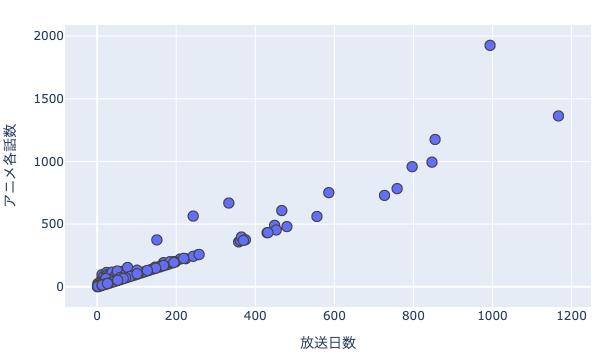

In [13]:
# アニメ作品の放送日数と各話数の関係を散布図で可視化
# x軸に放送日数、y軸に各話数を指定
fig = px.scatter(
    df_an,
    x="放送日数",
    y="アニメ各話数",
    hover_name="アニメ作品名",
)

# マーカーのスタイルを設定
# opacityは指定しない（デフォルト=1.0）
fig.update_traces(
    marker={
        "size": 10,
        "line_width": 1,
    }
)

# 散布図を表示
show_fig(fig)

```{admonition} 解説
:class: important
この散布図では、`opacity`を指定していないため、データ点が完全に不透明（デフォルト=1.0）で描画されています。
その結果、多くのデータ点が重なり合う領域（特に放送日数・各話数が少ない左下部分）では、 **オーバープロット** が発生し、実際にどれだけのデータ点が存在するのかが視覚的に把握しづらくなっています。

本書の散布図では `opacity=0.5` を設定することで、重なり合う領域が濃く表示され、データの密集度を直感的に把握できるようになっています。
散布図でデータ点が多い場合、透明度の調整は非常に有効な手法です。

**関連セクション**: 詳しくは[散布図](./scatter)を参照してください。
```

(vol2-04-a2)=
## {bdg-info}`基礎` 問題2：年ごとのゲームパッケージ数

**関連セクション**: [折れ線グラフ](./line)

折れ線グラフにおいて、各データ点にマーカーを表示するかどうかで印象が大きく変わります。
そこで本問では、 **あえてマーカーを表示しない** 設定とすることで、その影響を体験してみましょう。

ゲーム市場の動向を把握するために、年ごとのゲームパッケージ数の推移を可視化することは有用です。
折れ線グラフを用いることで、時系列データの変化を視覚的に捉えることができます。

`df_pkg_pf`（ゲームパッケージデータ）を用いて、年ごとのユニークな **ゲームパッケージ数** の推移を折れ線グラフで可視化してください。
なお、**`mode="lines"`** を指定し、マーカーは表示しないでください。

```{admonition} ヒント
:class: note dropdown
- 日付列を `pd.to_datetime()` で変換し、`.dt.year` で年を抽出できます
- 年ごとの集計は `groupby` と `nunique()` で行えます
- 折れ線グラフは `px.line()` で作成できます
- `update_traces(mode="lines")` でマーカーなしに設定できます
```

In [14]:
# 日付列を日付型に変換し、年を抽出
df_pkg_pf["date"] = pd.to_datetime(df_pkg_pf["date"])
df_pkg_pf["year"] = df_pkg_pf["date"].dt.year

# 年ごとにユニークなパッケージ数を集計
df_gm = df_pkg_pf.groupby("year")["pkgid"].nunique().reset_index()

# 可視化用にカラム名を変更
df_gm = df_gm.rename(
    columns={
        "year": "発売年",
        "pkgid": "ゲームパッケージ数",
    }
)

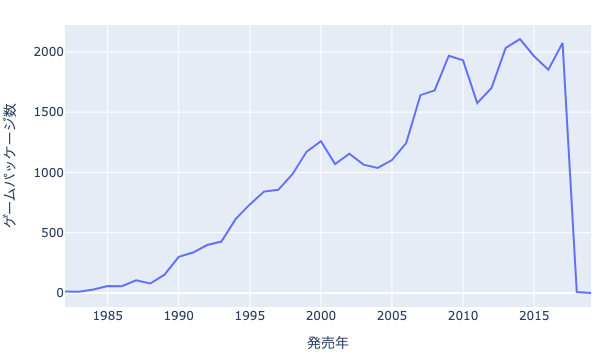

In [15]:
# 折れ線グラフを作成
# x軸に発売年、y軸にゲームパッケージ数を指定
fig = px.line(df_gm, x="発売年", y="ゲームパッケージ数")

# マーカーなしの線のみに設定
fig.update_traces(mode="lines")

# 折れ線グラフを表示
show_fig(fig)

```{admonition} 解説
:class: important
この折れ線グラフでは、`mode="lines"` を指定しているため、データ点を示すマーカーが表示されていません。
その結果、各年のデータ点がどこにあるのかが視覚的に把握しづらくなっています。

本書中の折れ線グラフでは `mode="lines+markers"` を設定することで、線とマーカーの両方が表示され、個々のデータ点の位置が明確になります。
特にデータ点が少ない場合や、特定の年の値を確認したい場合には、マーカーの表示が有効です。

**関連セクション**: 詳しくは[折れ線グラフ](./line)を参照してください。
```

(vol2-04-a3)=
## {bdg-success}`標準` 問題3：マンガ雑誌巻号の作品数と作者数の関係

**関連セクション**: [散布図](./scatter)

散布図において、データ点が離散的な値を取る場合、同じ座標に複数の点が重なってしまう（オーバープロット）問題が発生します。
ジッタリング（微小なランダムノイズの付加）は、この問題を緩和する手法の一つです。

`df_ce`（マンガ各話データ）と `df_cc_crt`（マンガ作品×作者データ）を用いて、雑誌巻号ごとの **作品数** と **作者数** を集計し、ジッタリングを適用した散布図を作成してください。
ジッタリングには先に定義した `add_jitter` 関数を使用し、**`scale=1.0`** を指定してください。

```{admonition} ヒント
:class: note dropdown
- 雑誌巻号ごとの集計は `groupby` と `nunique()` で行えます
- ジッタリングは `add_jitter(values, scale=1.0)` で適用できます
- 散布図は `px.scatter()` で作成できます
```

In [18]:
# マンガ作品と作者の紐づけ情報をマージ
df_cc_crt = pd.read_csv(DIR_CM / FN_CC_CRT)
df_cm = pd.merge(df_ce, df_cc_crt[["ccid", "crtid", "crtname"]], on="ccid", how="outer")

# 雑誌巻号ごとに作品数と作者数を集計
df_cm = (
    df_cm.groupby(["miname"])[["ccid", "crtid"]]
    .agg({"ccid": "nunique", "crtid": "nunique"})
    .reset_index()
)

# カラム名を変更
df_cm = df_cm.rename(
    columns={
        "miname": "マンガ雑誌巻号名",
        "ccid": "マンガ作品数",
        "crtid": "マンガ作者数",
    }
)

# scale=1.0でジッタリングを適用
df_cm["マンガ作品数（ジッタリング後）"] = add_jitter(df_cm["マンガ作品数"], scale=1.0, seed=0)
df_cm["マンガ作者数（ジッタリング後）"] = add_jitter(df_cm["マンガ作者数"], scale=1.0, seed=1)

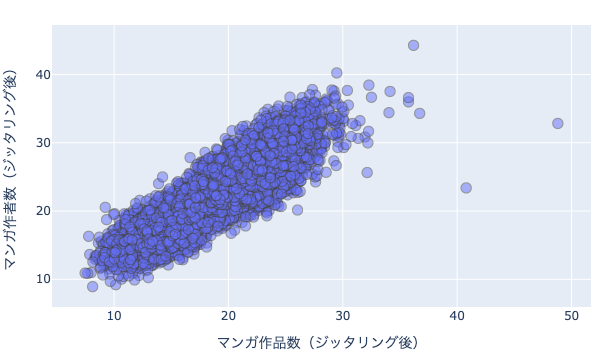

In [19]:
# ジッタリング適用後の散布図を作成
fig = px.scatter(
    df_cm,
    x="マンガ作品数（ジッタリング後）",
    y="マンガ作者数（ジッタリング後）",
    hover_name="マンガ雑誌巻号名",
    hover_data=["マンガ作品数", "マンガ作者数"],
)

# マーカーのスタイルを設定
fig.update_traces(
    marker={
        "size": 10,
        "line_width": 1,
        "opacity": 0.5,
    }
)

# 散布図を表示
show_fig(fig)

```{admonition} 解説
:class: important
この散布図では、`scale=1.0` という大きな値でジッタリングを適用しています。
その結果、元のデータが持つ整数値の傾向が大きく歪み、データ点が過度に散らばって見えます。

本書中の散布図では `scale=0.25` を使用しており、オーバープロットを緩和しつつも、元のデータの傾向（作品数と作者数がほぼ同じか、作品数の方が多い）を維持しています。
ジッタリングの `scale` 値は、データの特性と可視化の目的に応じて適切に選択する必要があります。
値が小さすぎるとオーバープロットが解消されず、大きすぎるとデータの傾向が歪んでしまいます。

**関連セクション**: 詳しくは[散布図](./scatter)を参照してください。
```

(vol2-04-a4)=
## {bdg-success}`標準` 問題4：任天堂プラットフォームのパッケージ数推移

**関連セクション**: [折れ線グラフ](./line)

折れ線グラフでは、データ点間をどのように補間するか（`line_shape`）によって、グラフの印象が大きく変わります。
線形補間（`linear`）、階段状補間（`hv`, `vh`）、スプライン曲線（`spline`）など、様々な補間方法があります。

`df_pkg_pf`（ゲームパッケージデータ）を用いて、**任天堂プラットフォーム全体**の年ごとのパッケージ数推移を、異なる `line_shape`（`linear`, `hv`, `spline`）で比較するサブプロットを作成してください。

```{admonition} ヒント
:class: note dropdown
- `PF2MK` 辞書を使って任天堂のプラットフォームを特定できます
- `make_subplots()` で複数のサブプロットを作成できます
- `go.Scatter()` の `line_shape` 引数で補間方法を指定できます
```

In [20]:
# 任天堂プラットフォームの一覧を取得
nintendo_pfs = [pf for pf, maker in PF2MK.items() if maker == "任天堂"]

# 任天堂プラットフォームに絞り込み
df_nintendo = df_pkg_pf[df_pkg_pf["pfname"].isin(nintendo_pfs)].copy()

# 年ごとにパッケージ数を集計（任天堂全体）
df_nintendo_yearly = df_nintendo.groupby("year")["pkgid"].nunique().reset_index()
df_nintendo_yearly = df_nintendo_yearly.rename(
    columns={"year": "発売年", "pkgid": "ゲームパッケージ数"}
)

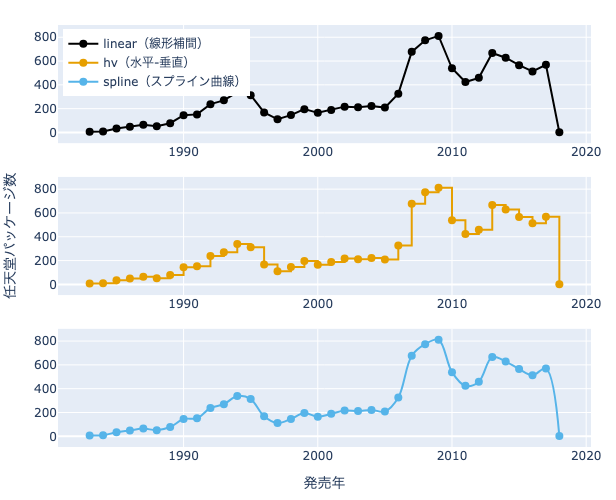

In [21]:
# 比較する補間方法のリスト
line_shapes = OrderedDict({
    "linear": "linear（線形補間）",
    "hv": "hv（水平-垂直）",
    "spline": "spline（スプライン曲線）",
})

# サブプロットを作成（縦に3つ並べる）
fig = make_subplots(rows=len(line_shapes), cols=1, vertical_spacing=0.08)

# 各補間方法でグラフを追加
for i, (shape, name) in enumerate(line_shapes.items()):
    fig.add_trace(
        go.Scatter(
            x=df_nintendo_yearly["発売年"],
            y=df_nintendo_yearly["ゲームパッケージ数"],
            mode="lines+markers",
            line_shape=shape,
            name=name,
            marker=dict(color=OKABE_ITO[i], size=8),
            line=dict(color=OKABE_ITO[i]),
        ),
        row=i + 1,
        col=1,
    )

# レイアウトを調整
fig.update_layout(
    height=500,
    legend=dict(x=0.01, y=0.99, xanchor="left", yanchor="top"),
)

# Y軸ラベルを中央のサブプロットに追加
fig.update_yaxes(title_text="任天堂パッケージ数", row=2, col=1)
# X軸ラベルを最下部のサブプロットに追加
fig.update_xaxes(title_text="発売年", row=len(line_shapes), col=1)

# サブプロットを表示
show_fig(fig)

```{admonition} 解説
:class: important
3つの補間方法を比較すると、同じデータでもグラフの印象が大きく異なることがわかります。

- **linear（線形補間）**: データ点間を直線で結ぶ最も基本的な方法。変化の傾向を素直に表現します。
- **hv（水平-垂直）**: 階段状に描画されるため、「ある時点で値が変化した」という解釈がしやすくなります。離散的なイベント（年単位の集計など）に適しています。
- **spline（スプライン曲線）**: 滑らかな曲線で描画されるため、連続的な変化を強調します。ただし、実際のデータ点間に存在しない値を示唆する可能性があるため、解釈には注意が必要です。

補間方法の選択は、データの性質と伝えたいメッセージに応じて適切に行う必要があります。

**関連セクション**: 詳しくは[折れ線グラフ](./line)を参照してください。
```

(vol2-04-a5)=
## {bdg-warning}`発展` 問題5：アニメ放送枠の作品数と話数の関係

**関連セクション**: [連結散布図](./connected)

ある期間中のアニメの作品数と話数の関係は、その放送枠の性質（長期作品が多いか、短期作品の入れ替えが激しいか）を反映します。

`df_ae`（アニメ各話データ）を用いて、 **「平日放送のみの作品群」と「土日放送のみの作品群」** で、作品数と話数のバランスがどう異なるかを、連結散布図で可視化してください。

```{admonition} ヒント
:class: note dropdown
- 土日判定は `.dt.weekday >= 5` で行えます
- 作品ごとの曜日種別数は `groupby` と `nunique()` で確認できます
- 連結散布図は `create_connectedplot()` 関数で作成できます
- ファセット分割は `facet_col` 引数で指定します
```

In [23]:
# 日付型への変換と「土日かどうか」のフラグ付与
df_ae["date"] = pd.to_datetime(df_ae["date"])
df_ae["is_weekend"] = df_ae["date"].dt.weekday >= 5
df_ae["year"] = df_ae["date"].dt.year

# 作品ごとに「放送曜日タイプ」を判定
# weekdayのユニーク数が1かつTrueなら「土日のみ」、Falseなら「平日のみ」
work_day_counts = df_ae.groupby("acid")["is_weekend"].nunique()
strictly_one_type = work_day_counts[work_day_counts == 1].index
df_q5_filtered = df_ae[df_ae["acid"].isin(strictly_one_type)].copy()
df_q5_filtered["day_label"] = df_q5_filtered["is_weekend"].map(
    {True: "土日放送", False: "平日放送"}
)

# 年・曜日タイプごとにユニークな作品数と話数を集計
df_q5 = (
    df_q5_filtered.groupby(["year", "day_label"])[["acid", "aeid"]]
    .nunique()
    .reset_index()
)
# 可視化用にアノテーション用の列を追加
df_q5["anot"] = df_q5["year"].apply(lambda x: x if x % 10 == 0 else None)

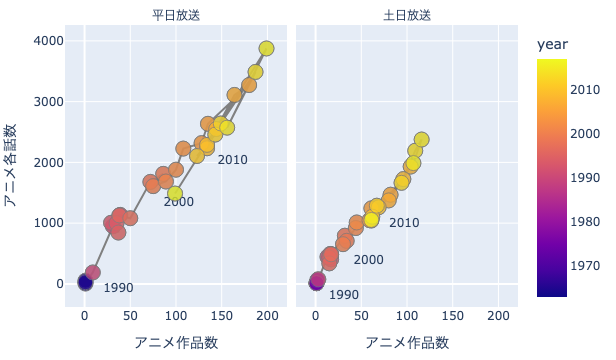

In [24]:
# 連結散布図の作成（create_connectedplot関数を利用）
# x軸に作品数、y軸に各話数、時系列を色で表現
fig = create_connectedplot(
    df_q5,
    x="acid",
    y="aeid",
    color="year",
    facet_col="day_label",
    text="anot", 
    labels={"acid": "アニメ作品数", "aeid": "アニメ各話数", "day_label": "放送タイプ"},
)

# ファセットタイトルの整形
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 可視化結果を表示
show_fig(fig)

```{admonition} 解説
:class: important
連結散布図において、原点と各点を結ぶ直線の傾き $\frac{y}{x}$ は「1作品あたりの平均話数」を意味します。

土日放送と平日放送において、その大局的な傾きには大きな違いはないように見えます。
しかし、平日放送のほうが比較的マーカーの推移に「ぶれ」が見られ、何らかの要因により「1作品あたりの平均話数」は変動しやすい傾向があるように見えます。

平日放送の方が「アニメ作品数」「アニメ各話数」ともに成長が早いように見えますが、日数の違い（平日：5日間、土日：2日間）が影響している可能性があります。
各指標を該当する日数で割ることで、この要因を除外した分析に近づく可能性があります。

**関連セクション**: 詳しくは[連結散布図](./connected)を参照してください。
```

(vol2-04-a6)=
## {bdg-danger}`応用` 問題6：マンガ掲載位置の遷移

**関連セクション**: [等値線図](./contour)

マンガ雑誌において、ある作品の「現在の掲載位置」が「次号の掲載位置」にどの程度影響するかは、連載の安定性を測る指標の一つです。掲載順が固定されていればデータ点は直線 $y=x$ 付近に集中し、変動が激しければ分散します。

`df_ce`（マンガ各話データ）を用いて、連載初期から中盤にかけてこの遷移傾向がどう変化するかを等値線図で可視化しましょう。
横軸に現在の掲載位置、縦軸に次話の掲載位置を取り、話数レンジ（1-10話、11-20話、21-30話、31-40話）ごとにファセットをわけてください。

```{admonition} ヒント
:class: note dropdown
- 「次話の掲載位置」は `groupby` と `shift(-1)` で算出できます
- 作品内の話数インデックスは `cumcount()` で付与できます
- 等値線図は `px.density_contour()` で作成できます
- `contours_coloring="fill"` で密度に応じた塗り分けができます
```

In [25]:
# 前処理：次話の掲載位置（next_psp）を算出
# 作品(ccid)ごとに日付(date)順でソートし、掲載位置を一つずらす
df_ce = df_ce.sort_values(["ccid", "date"])
df_ce["next_psp"] = df_ce.groupby("ccid")["page_start_position"].shift(-1)

# 次話が存在しない最終話を除外
df_q6 = df_ce.dropna(subset=["next_psp"]).copy()

# 話数レンジ（ceidx）を付与するためのラベル関数を定義
def get_range_label(n):
    if 1 <= n <= 10: return "01-10話"
    if 11 <= n <= 20: return "11-20話"
    if 21 <= n <= 30: return "21-30話"
    if 31 <= n <= 40: return "31-40話"
    return None

# 作品内の累積話数をインデックスとして付与し、ラベル付けを行う
df_q6["ceidx"] = df_q6.groupby("ccid").cumcount() + 1
df_q6["range"] = df_q6["ceidx"].apply(get_range_label)
df_q6 = df_q6.dropna(subset=["range"])

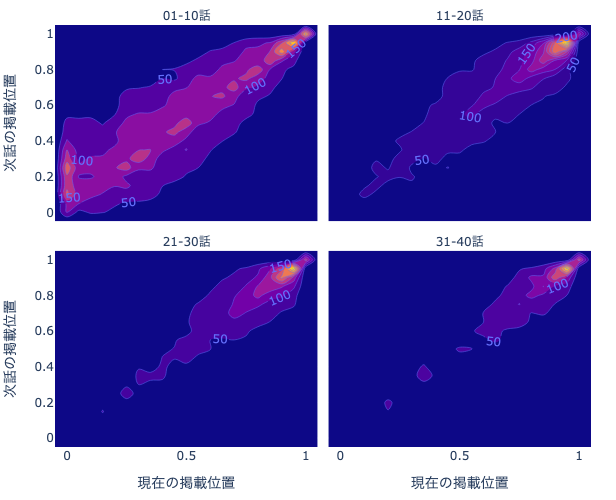

In [26]:
# Plotlyによる等値線図の作成
# x軸に「現在の位置」、y軸に「次話の位置」を指定し、話数レンジでファセットを分ける
fig = px.density_contour(
    df_q6,
    x="page_start_position",
    y="next_psp",
    facet_col="range",
    facet_col_wrap=2,
    labels={"page_start_position": "現在の掲載位置", "next_psp": "次話の掲載位置"},
    height=500,
)

# 視認性を高めるため、密度に応じた塗り分けと数値ラベルを表示
fig.update_traces(contours_coloring="fill", contours_showlabels=True, showscale=False)

# ファセットタイトルの「range=」部分を除去して整形
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 可視化結果を表示
show_fig(fig)

```{admonition} 解説
:class: important
等値線図は、散布図では点同士の重複（オーバープロット）で隠れてしまう「データの集中度合い」を可視化するのに適しています。

図を観察すると、いずれの話数レンジにおいても対角線 $y=x$ に沿ってピークが形成されており、現在の掲載位置が次話に引き継がれやすい傾向が見て取れます。
特に連載が進む（レンジが後半になる）ほど、等値線の広がりがタイトになり、掲載位置の固定化が進む様子が推測されます。

なお、本書では掲載位置の「分布」（スナップショット）に注目した議論が中心でしたが、本問のように「遷移」という動的な観点を導入することで、マンガ雑誌というシステムの異なる側面を捉えることができます[^transition]。

[^transition]: 例えば、雑誌ごとにこの遷移図を比較すれば編集方針の違いが見えるかもしれませんし、対角線からの逸脱パターン（急上昇・急降下）を分析すれば、新連載の定着過程や打ち切りの兆候を可視化できる可能性があります。

**関連セクション**: 詳しくは[等値線図](./contour)を参照してください。
```

(vol2-04-a7)=
## {bdg-danger}`応用` 問題7：経過年によるパッケージ数の推移

**関連セクション**: [折れ線グラフ](./line)

ゲームプラットフォームには、発売から普及、そして衰退までのライフサイクルがあります。
西暦ではなく、 **発売からの経過年** を軸に据えることで、異なる世代のプラットフォーム同士を同じ基準で比較できます。

`df_pkg_pf`（ゲームパッケージデータ）を用いて、歴代の「プレイステーション」シリーズを対象に、発売から何年目に最も多くのソフト（パッケージ数）が供給されたかを折れ線グラフで可視化してみましょう。

```{admonition} ヒント
:class: note dropdown
- 文字列フィルタリングは `str.contains()` で行えます
- 経過年インデックスは `groupby` と `cumcount()` で算出できます
- 折れ線グラフは `px.line()` で作成できます
- `mode="lines+markers"` で線とマーカーの両方を表示できます
```

In [27]:
# 年情報の抽出
df_pkg_pf["date"] = pd.to_datetime(df_pkg_pf["date"])
df_pkg_pf["year"] = df_pkg_pf["date"].dt.year

# プラットフォーム×年ごとのパッケージ数を集計
df_q7 = (
    df_pkg_pf.groupby(["year", "pfname"])["pkgid"]
    .nunique()
    .reset_index()
)

# 2017年までを対象とし、「プレイステーション」シリーズに限定
df_q7 = df_q7[df_q7["year"] <= 2017]
df_q7 = df_q7[df_q7["pfname"].str.contains("プレイステーション")]

# プラットフォームごとに「発売からの経過年（year_index）」を算出
# グループ化してcumcount()を用いることで、各PFの登場順に1, 2, 3...と採番
df_q7 = df_q7.sort_values(["pfname", "year"])
df_q7["year_index"] = df_q7.groupby("pfname").cumcount() + 1

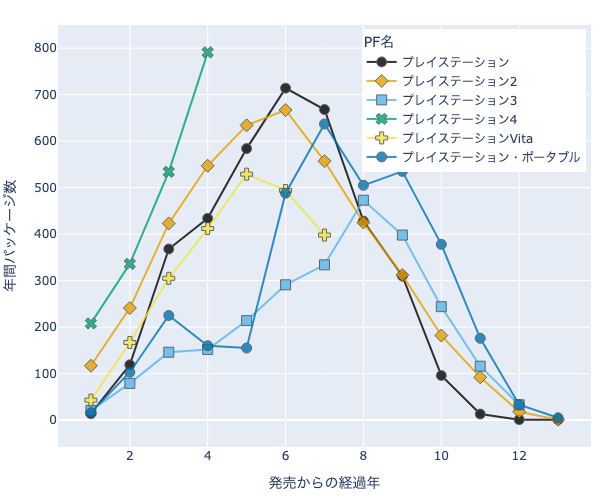

In [28]:
# 折れ線グラフの作成
# 凡例の順序を一定にするためOKABE_ITOパレットを使用
fig = px.line(
    df_q7,
    x="year_index",
    y="pkgid",
    color="pfname",
    symbol="pfname",
    color_discrete_sequence=OKABE_ITO,
    labels={"year_index": "発売からの経過年", "pkgid": "年間パッケージ数", "pfname": "PF名"},
    height=500,
)

# マーカーと線の両方を表示し、視認性を調整
fig.update_traces(mode="lines+markers", marker=dict(line_width=1, size=10), opacity=0.8)

# 凡例の位置を右上に配置してグラフ領域を確保
fig.update_layout(
    legend=dict(yanchor="top", y=0.99, xanchor="right", x=0.99),
)

# 可視化結果を表示
show_fig(fig)

```{admonition} 解説
:class: important
折れ線グラフは、時系列データの **変化** を比較するのに最適です。 
経過年（`year_index`）を横軸にとることで、例えば「PSとPS2は6年目にピークを迎えたが、PS3は8年目にピークが来ている」といった、プラットフォームごとの市場成熟スピードの違いに関する示唆が得られます。
このように、データの基準点を揃える前処理と可視化を組み合わせることで、より本質的な比較が可能になるのです。

**関連セクション**: 詳しくは[折れ線グラフ](./line)を参照してください。
```